In [4]:
import torch
import os
import glob
from IPython.display import Image, display

%cd yolov5
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

c:\Users\Yang_PC\Documents\Github\yolo-fire-detection\yolov5
Setup complete. Using torch 2.1.1+cu118 (NVIDIA GeForce RTX 3060)


# Train YOLOv5 model

In [5]:
!python train.py --img 640 --batch 16 --epochs 3 --data ../fire-dataset-path.yaml --weights yolov5s.pt --workers 1

^C


# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

In [6]:
from utils.plots import plot_results
plot_results('runs/train/exp/results.csv')

### Prediction on Images

In [7]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source C:/Users/Yang_PC/Documents/rfan/fire/val/images/

detect: weights=['runs/train/exp/weights/best.pt'], source=C:/Users/Yang_PC/Documents/rfan/fire/val/images/, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  v7.0-297-gd07d0cf6 Python-3.10.14 torch-2.1.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060, 12287MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/150 C:\Users\Yang_PC\Documents\rfan\fire\val\images\0.jpg: 480x640 1 fire, 231.4ms
image 2/150 C:\Users\Yang_PC\Documents\rfan\fire\val\images\0016f8c09384627e.jpg: 480x640 2 fires, 15.0ms
image 3/150 C:\Users\Yang_PC\Documents\rfan\fire\val\images\004dec94c5de631f.jpg: 480x640

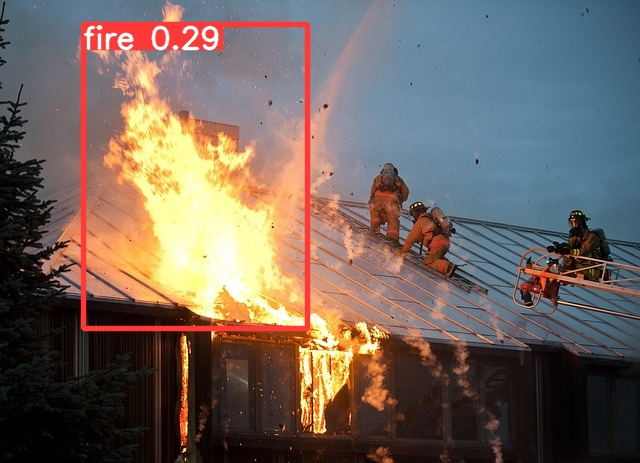

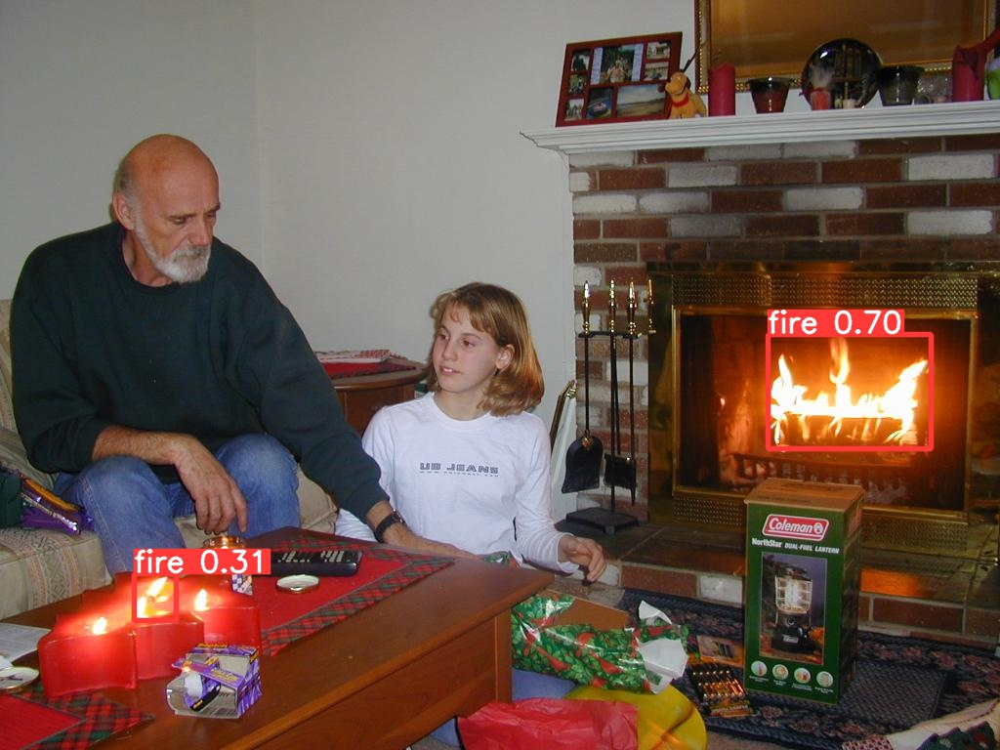

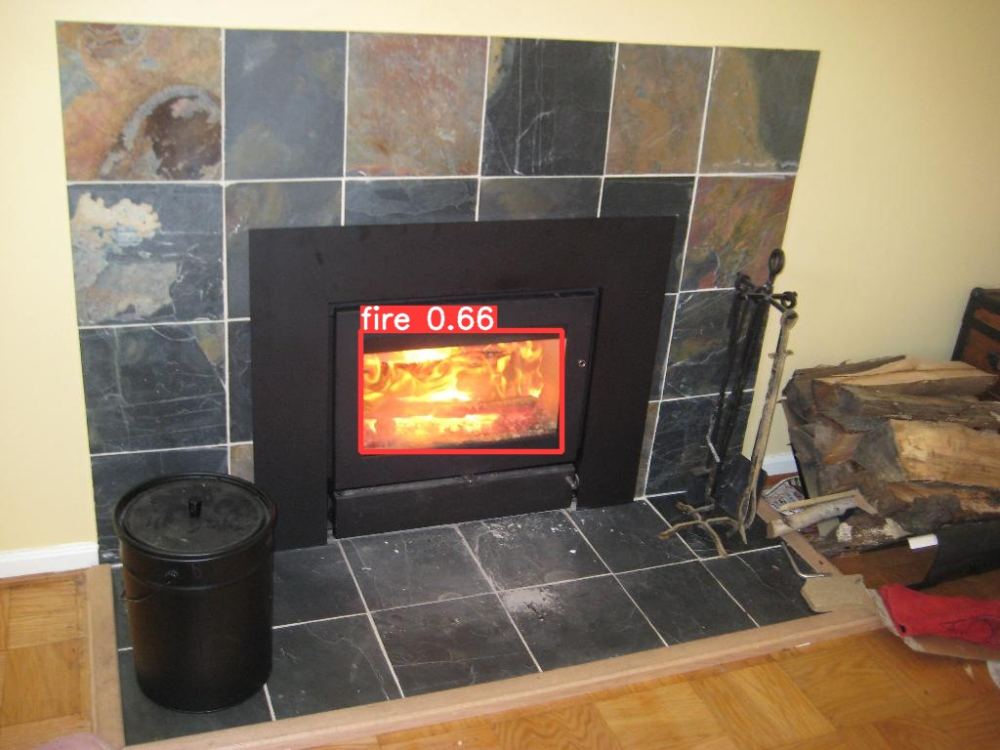

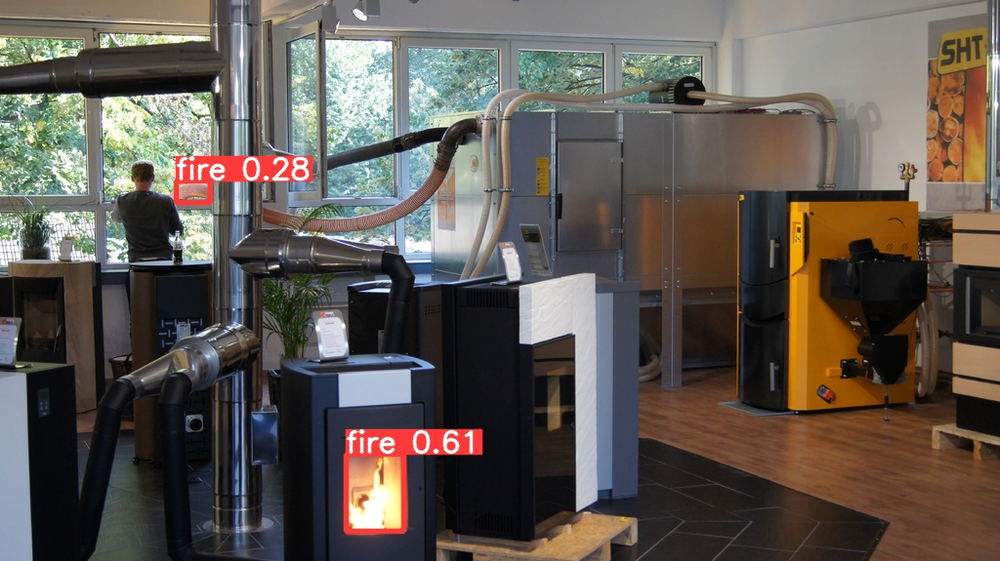

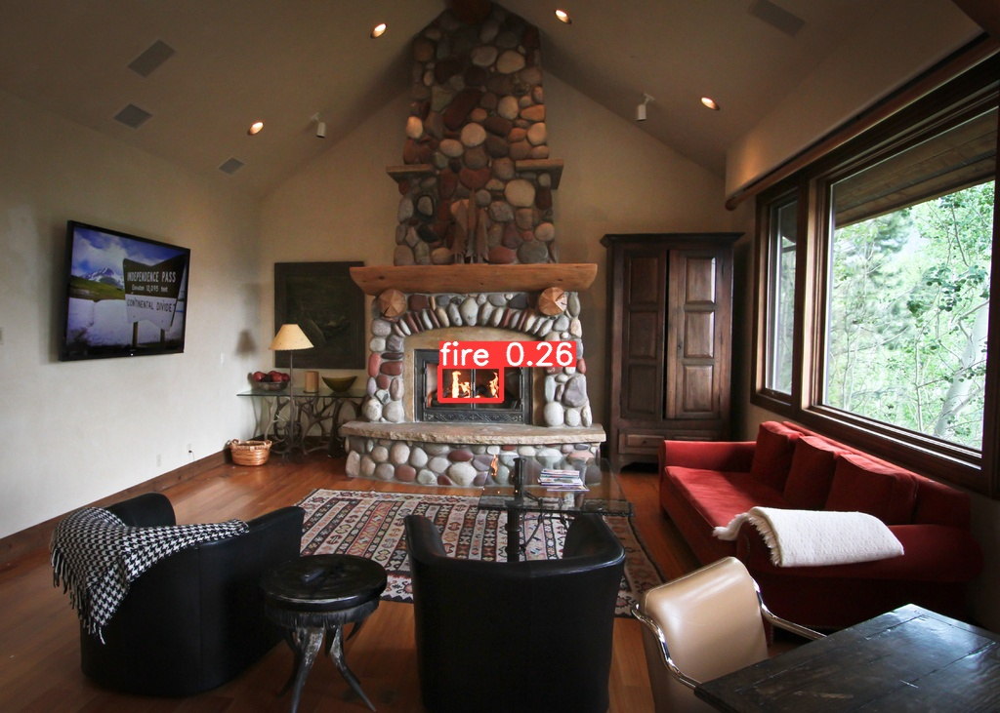

In [8]:
#display inference on some test images
images = glob.glob('runs/detect/exp3/*.jpg')

for imageName in images[:5]: #assuming JPG
    display(Image(filename=imageName, width=400))

### Prediction on Video 

In [3]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source C:/Users/Yang_PC/Documents/rfan/fire-video/dji_fly.mp4

python: can't open file 'c:\\Users\\Yang_PC\\Documents\\Github\\yolo-fire-detection\\detect.py': [Errno 2] No such file or directory


In [9]:
import cv2
vidcap = cv2.VideoCapture('runs/detect/exp2/dji_fly.mp4')
success,image = vidcap.read()
images = []
while success:
    success,image = vidcap.read()
    if success:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        images.append(image)

In [10]:
images

[array([[[ 67, 137, 191],
         [ 67, 137, 191],
         [ 67, 137, 191],
         ...,
         [ 49,  43,  48],
         [ 49,  43,  48],
         [ 49,  43,  48]],
 
        [[ 67, 137, 191],
         [ 67, 137, 191],
         [ 67, 137, 191],
         ...,
         [ 49,  43,  48],
         [ 49,  43,  48],
         [ 49,  43,  48]],
 
        [[ 67, 137, 191],
         [ 67, 137, 191],
         [ 67, 137, 191],
         ...,
         [ 49,  43,  48],
         [ 49,  43,  48],
         [ 49,  43,  48]],
 
        ...,
 
        [[102, 106,  77],
         [ 94,  98,  69],
         [ 87,  91,  62],
         ...,
         [150, 125, 108],
         [155, 130, 113],
         [161, 136, 119]],
 
        [[107, 111,  82],
         [104, 108,  79],
         [101, 105,  76],
         ...,
         [173, 148, 131],
         [173, 148, 131],
         [173, 148, 131]],
 
        [[146, 150, 121],
         [143, 147, 118],
         [131, 135, 106],
         ...,
         [197, 172, 155],
  

In [11]:
from matplotlib import animation, rc
import matplotlib.pyplot as plt

rc('animation', html='jshtml')

def create_animation(ims):
    fig = plt.figure(figsize=(9, 9))
    plt.axis('off')
    im = plt.imshow(ims[0])

    def animate_func(i):
        im.set_array(ims[i])
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames = len(ims), interval = 1000//12)

create_animation(images)

Animation size has reached 21439919 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
